<a href="https://colab.research.google.com/github/Neruoy/Vision-based-robotic-grasping-system-using-deep-learning/blob/main/transfer_model_04_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Check GPU

In [1]:
!nvidia-smi

Fri Jun  4 11:48:35 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P0    32W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Set Up

## Import libraries

In [2]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
import random
import pandas as pd
import sklearn
import pickle
import math
import copy

## Get pickle data

In [3]:
data_path = '/content/drive/MyDrive/DLOD/grasp_share/Alan/20210531_grasp_dataset'
with open(os.path.join(data_path, '_x_train'), 'rb') as file:
  x_train = pickle.load(file)
with open(os.path.join(data_path, '_y_train'), 'rb') as file:
  y_train = pickle.load(file)
with open(os.path.join(data_path, '_x_val'), 'rb') as file:
  x_valid = pickle.load(file)
with open(os.path.join(data_path, '_y_val'), 'rb') as file:
  y_valid = pickle.load(file)
with open(os.path.join(data_path, '_x_test'), 'rb') as file:
  x_test = pickle.load(file)
with open(os.path.join(data_path, '_y_test'), 'rb') as file:
  y_test = pickle.load(file)

In [4]:
y_train = y_train.astype(np.float32)
y_valid = y_valid.astype(np.float32)
y_test = y_test.astype(np.float32)

In [5]:
print("train size: {}, valid size: {}, test size: {}".format(y_train.shape[0], y_valid.shape[0], y_test.shape[0]))

train size: 126, valid size: 36, test size: 36


In [6]:
y_train_reg, y_train_cls = y_train[:, :5], y_train[:, 5:]
y_valid_reg, y_valid_cls = y_valid[:, :5], y_valid[:, 5:]
y_test_reg, y_test_cls = y_test[:, :5], y_test[:, 5:]

## Set parameters

In [7]:
(HEIGHT, WIDTH, CHANNELS) = x_train[0].shape
INPUT_SIZE = (224, 224, 3)
m = y_train.shape[0]
OUTPUT_SIZE = y_train.shape[1]
BATCH_SIZE = 32

In [8]:
(HEIGHT, WIDTH, CHANNELS)

(720, 1280, 3)

# Data prepocessing

## Define funtions

For data prepocessing


In [94]:
@tf.function
def prepocess_img(img, input_size=INPUT_SIZE):
  input_img = tf.image.resize(img, size=[input_size[0], input_size[1]])
  input_img = tf.divide(input_img, 255.)
  return input_img

@tf.function
def invprepocess_img(img, w=WIDTH, h=HEIGHT):
  input_img = tf.image.resize(img, size=[720, 1280])
  return input_img

# @tf.function
# def prepocess_lab(lab, h=HEIGHT, w=WIDTH):
#   scaler = tf.constant([WIDTH, HEIGHT] * 3, dtype=tf.float32)
#   normalize_lab = tf.multiply(lab, scaler)
#   return normalize_lab

# @tf.function
# def invnor_lab(lab, h=HEIGHT, w=WIDTH):
#   scaler = tf.constant([WIDTH, HEIGHT] * 3, dtype=tf.float32)
#   invnormalize_lab = tf.divide(lab, scaler)
#   return invnormalize_lab

For drawing bounding box

$$
\text{label}=
\begin{equation}
\begin{cases}
[x,y,w,h,\theta,1,0,0], & \text{for type1} \\
[x,y,w,h,\theta,0,1,0], & \text{for type2} \\
[x,y,w,h,\theta,0,0,1], & \text{for type3}
\end{cases}
\end{equation}
$$

In [10]:
def label2pts(lab):
  rec_param, class_param = lab[:5], lab[5:]
  x, y, w, h, theta = tuple(param for param in rec_param)
  r = np.sqrt(w**2 + h**2) / 2
  theta0 = np.arctan(h / w)

  def polar2cart(r, theta):
    return r * np.cos(theta), r * np.sin(theta)
  
  pt1 = (x + polar2cart(r, theta0 + theta)[0], y + polar2cart(r, theta0 + theta)[1])
  pt2 = (x + polar2cart(r, np.pi - theta0 + theta)[0], y + polar2cart(r, np.pi - theta0 + theta)[1])
  pt3 = (x + polar2cart(r, np.pi + theta0 + theta)[0], y + polar2cart(r, np.pi + theta0 + theta)[1])
  pt4 = (x + polar2cart(r, -theta0 + theta)[0], y + polar2cart(r, -theta0 + theta)[1])

  pt1 = tuple(np.array(pt1, dtype=int))
  pt2 = tuple(np.array(pt2, dtype=int))
  pt3 = tuple(np.array(pt3, dtype=int))
  pt4 = tuple(np.array(pt4, dtype=int))

  return pt1, pt2, pt3, pt4

def draw_box(images, labs):
  imgs = copy.deepcopy(images)
  for img, lab in zip(imgs, labs):
    pt1, pt2, pt3, pt4 = label2pts(lab)

    f = plt.figure(figsize=(12, 9))
    cv2.line(img, pt1, pt2, (0,0,255), 3)
    cv2.line(img, pt2, pt3, (0,0,255), 3)
    cv2.line(img, pt3, pt4, (0,0,255), 3)
    cv2.line(img, pt4, pt1, (0,0,255), 3)
    plt.axis(False)
    plt.imshow(img)

Result

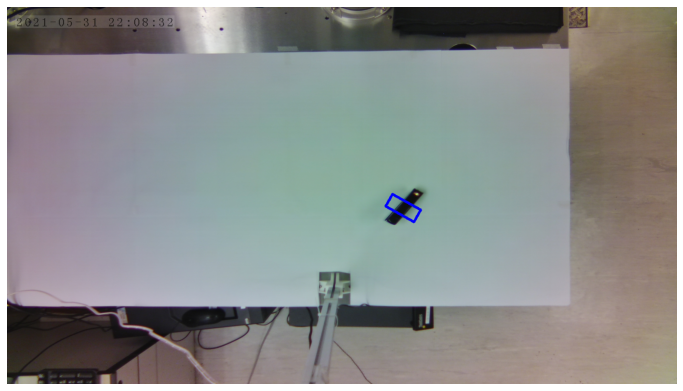

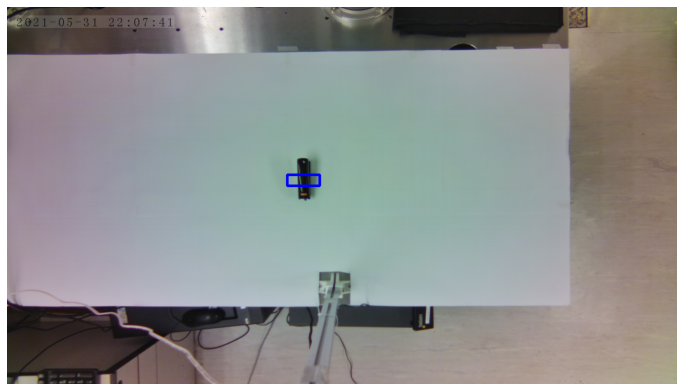

In [12]:
index = 2
img, lab = x_train[:index], y_train[:index]
draw_box(img, lab)

## Prepocess

Normalize label

In [13]:
############################### TEST ###############################

In [14]:
from sklearn.preprocessing import MinMaxScaler

In [15]:
scaler = MinMaxScaler()

In [16]:
y_reg = np.concatenate((y_train_reg, y_valid_reg, y_test_reg), axis=0)

In [17]:
scaler = scaler.fit(y_reg)

In [18]:
nor_y_train_reg = scaler.transform(y_train_reg)
nor_y_valid_reg = scaler.transform(y_valid_reg)
nor_y_test_reg = scaler.transform(y_test_reg)

In [19]:
############################### TEST ###############################

In [20]:
AUTOTUNE = tf.data.AUTOTUNE

In [21]:
x_train_ds_pre = tf.data.Dataset.from_tensor_slices(x_train)
x_train_ds = x_train_ds_pre.map(prepocess_img, num_parallel_calls=AUTOTUNE)
y_train_reg_ds = tf.data.Dataset.from_tensor_slices(nor_y_train_reg)
y_train_cls_ds = tf.data.Dataset.from_tensor_slices(y_train_cls)
train_ds = tf.data.Dataset.zip((x_train_ds, y_train_reg_ds)).shuffle(m).batch(BATCH_SIZE)
train_ds.prefetch(AUTOTUNE)

<PrefetchDataset shapes: ((None, 224, 224, 3), (None, 5)), types: (tf.float32, tf.float32)>

In [22]:
x_valid_ds_pre = tf.data.Dataset.from_tensor_slices(x_valid)
x_valid_ds = x_valid_ds_pre.map(prepocess_img, num_parallel_calls=AUTOTUNE)
y_valid_reg_ds = tf.data.Dataset.from_tensor_slices(nor_y_valid_reg)
y_valid_cls_ds = tf.data.Dataset.from_tensor_slices(y_valid_cls)
valid_ds = tf.data.Dataset.zip((x_valid_ds, y_valid_reg_ds)).shuffle(m).batch(BATCH_SIZE)
valid_ds.prefetch(AUTOTUNE)

<PrefetchDataset shapes: ((None, 224, 224, 3), (None, 5)), types: (tf.float32, tf.float32)>

In [23]:
x_test_ds_pre = tf.data.Dataset.from_tensor_slices(x_test)
x_test_ds = x_test_ds_pre.map(prepocess_img, num_parallel_calls=AUTOTUNE)
y_test_reg_ds = tf.data.Dataset.from_tensor_slices(nor_y_test_reg)
y_test_cls_ds = tf.data.Dataset.from_tensor_slices(y_test_cls)
test_ds = tf.data.Dataset.zip((x_test_ds, y_test_reg_ds)).shuffle(m).batch(BATCH_SIZE)
test_ds.prefetch(AUTOTUNE)

<PrefetchDataset shapes: ((None, 224, 224, 3), (None, 5)), types: (tf.float32, tf.float32)>

# Construct model

## Base model

In [24]:
base_model = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet', input_shape=INPUT_SIZE)
base_model.trainable = False

80142336/80134624 [==============================] - 1s 0us/step


## Customize output

#### Model 1 (Normal)

In [25]:
x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(4096, kernel_initializer='he_normal')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.ELU()(x)
x = tf.keras.layers.Dropout(rate=0.2)(x)
x = tf.keras.layers.Dense(1024, kernel_initializer='he_normal')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.ELU()(x)
x = tf.keras.layers.Dropout(rate=0.2)(x)
x = tf.keras.layers.Dense(256, kernel_initializer='he_normal')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.ELU()(x)
# x = tf.keras.layers.Dropout(rate=0.2)(x)
outputs = tf.keras.layers.Dense(5)(x)

model = tf.keras.models.Model(base_model.input, outputs)

In [26]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

## Customize loss functions

#### mixLoss

In [27]:
# def mixLoss(y_true, y_pred):
#   reg_loss = tf.keras.losses.MSE(y_true[:, :4], y_pred[:, :4])
#   reg_loss = tf.reduce_sum(reg_loss, axis=1)
#   cls_loss = tf.keras.losses.CategoricalCrossentropy(y_true[:, 4:], y_pred[:,4:])
#   cls_loss = tf.reduce_sum(cls_loss, axis=1)
#   return 0.8 * reg_error + 0.2 * cls_loss

In [28]:
def mixLoss(y_true, y_pred):
    xy_loss = tf.keras.losses.MSE(y_true[:,0:2],y_pred[:,0:2])    
    wh_loss = tf.keras.losses.MSE(y_true[:,2:4],y_pred[:,2:4])   
    class_loss = tf.keras.losses.CategoricalCrossentropy(y_true[:,4:], y_pred[:,4:])
    return xy_loss + wh_loss

#### huber_Loss

In [29]:
def create_huber(threshold=0.2):
  def huber_fn(y_true, y_pred):
    error = y_true - y_pred
    is_small_error = tf.abs(error) < threshold
    squared_loss = tf.square(error) / 2
    linear_loss = threshold * tf.abs(error) - threshold**2 / 2
    return tf.where(is_small_error, squared_loss, linear_loss)
  return huber_fn

#### GIoU loss


In [30]:
def giouLoss(y_true, y_pred):
  pt1_true, pt2_true, pt3_true, pt4_true = label2pts(y_true)
  pt1_pred, pt2_pred, pt3_pred, pt4_pred = label2pts(y_pred)
  gl = tfa.losses.GIoULoss()
  boxes1 = tf.constant([[4.0, 3.0, 7.0, 5.0], [5.0, 6.0, 10.0, 7.0]])
  boxes2 = tf.constant([[3.0, 4.0, 6.0, 8.0], [14.0, 14.0, 15.0, 15.0]])
  loss = gl(boxes1, boxes2)

## Compile the model

In [31]:
optimizer = tf.keras.optimizers.Adam(learning_rate=3e-5)
model.compile(optimizer=optimizer, loss=mixLoss)

# Training

In [32]:
n_epochs = 2000

In [33]:
# K = tf.keras.backend

# class OneCycleScheduler(tf.keras.callbacks.Callback):
#     def __init__(self, iterations, max_rate, start_rate=None,
#                  last_iterations=None, last_rate=None):
#         self.iterations = iterations
#         self.max_rate = max_rate
#         self.start_rate = start_rate or max_rate / 10
#         self.last_iterations = last_iterations or iterations // 10 + 1
#         self.half_iteration = (iterations - self.last_iterations) // 2
#         self.last_rate = last_rate or self.start_rate / 1000
#         self.iteration = 0
#     def _interpolate(self, iter1, iter2, rate1, rate2):
#         return ((rate2 - rate1) * (self.iteration - iter1)
#                 / (iter2 - iter1) + rate1)
#     def on_batch_begin(self, batch, logs):
#         if self.iteration < self.half_iteration:
#             rate = self._interpolate(0, self.half_iteration, self.start_rate, self.max_rate)
#         elif self.iteration < 2 * self.half_iteration:
#             rate = self._interpolate(self.half_iteration, 2 * self.half_iteration,
#                                      self.max_rate, self.start_rate)
#         else:
#             rate = self._interpolate(2 * self.half_iteration, self.iterations,
#                                      self.start_rate, self.last_rate)
#         self.iteration += 1
#         K.set_value(self.model.optimizer.lr, rate)

# onecycle = OneCycleScheduler(math.ceil(m / BATCH_SIZE) * n_epochs, max_rate=0.5)

In [34]:
!rm -rf /content/vgg19_tf.h5

In [35]:
run_index = 5
run_logdir = os.path.join(os.curdir, "logs", "run_{:03d}".format(run_index))
tensorboard_cb = tf.keras.callbacks.TensorBoard(run_logdir)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint('vgg19_tf.h5', save_best_only=True)
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=100, restore_best_weights=True)
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=50)

history = model.fit(train_ds, 
                    epochs=n_epochs,
                    validation_data=valid_ds,
                    callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_cb, lr_scheduler])

Epoch 1/2000
4/4 [==============================] - 24s 2s/step - loss: 2.5627 - val_loss: 2.3589
Epoch 2/2000
4/4 [==============================] - 1s 148ms/step - loss: 1.8023 - val_loss: 2.3771
Epoch 3/2000
4/4 [==============================] - 1s 149ms/step - loss: 1.7203 - val_loss: 2.5413
Epoch 4/2000
4/4 [==============================] - 1s 151ms/step - loss: 1.7051 - val_loss: 2.5506
Epoch 5/2000
4/4 [==============================] - 1s 148ms/step - loss: 1.8098 - val_loss: 2.3242
Epoch 6/2000
4/4 [==============================] - 1s 148ms/step - loss: 1.4718 - val_loss: 2.1425
Epoch 7/2000
4/4 [==============================] - 1s 151ms/step - loss: 1.3996 - val_loss: 2.0333
Epoch 8/2000
4/4 [==============================] - 1s 150ms/step - loss: 1.3774 - val_loss: 2.1077
Epoch 9/2000
4/4 [==============================] - 1s 150ms/step - loss: 1.3758 - val_loss: 2.3278
Epoch 10/2000
4/4 [==============================] - 1s 149ms/step - loss: 1.4002 - val_loss: 2.3979
E

In [36]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [111]:
final_model = tf.keras.models.load_model('vgg19_tf.h5', custom_objects={'mixLoss': mixLoss})

# Evaluation

In [112]:
############################ TEST ON TRAIN ############################

In [113]:
print('Performance on train set: {}'.format(final_model.evaluate(train_ds)))

4/4 [==============================] - 1s 80ms/step - loss: 0.0021
Performance on train set: 0.0021321061067283154


In [114]:
train_output = final_model.predict(train_ds)
train_pred = scaler.inverse_transform(train_output)
train_set = train_ds.unbatch()
train_imgs_set = train_set.map(invprepocess_img, num_parallel_calls=AUTOTUNE)
train_imgs_tensors = np.array([item for item in train_imgs_set])
train_imgs = [tensor for tensor in train_imgs_tensors]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

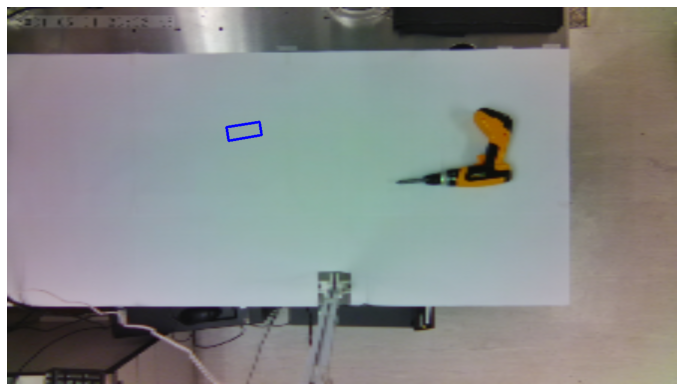

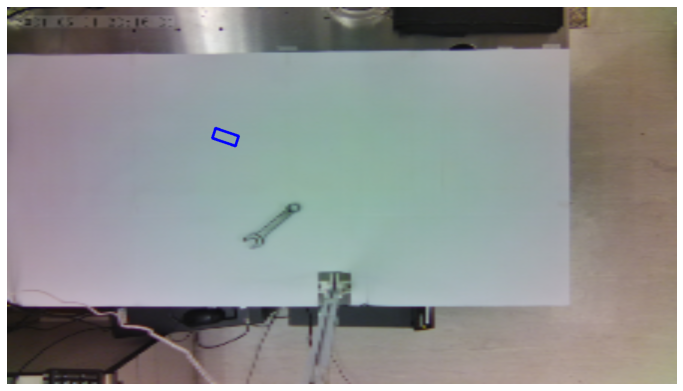

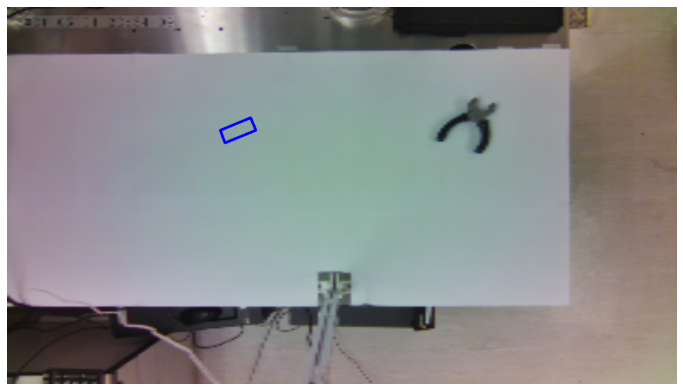

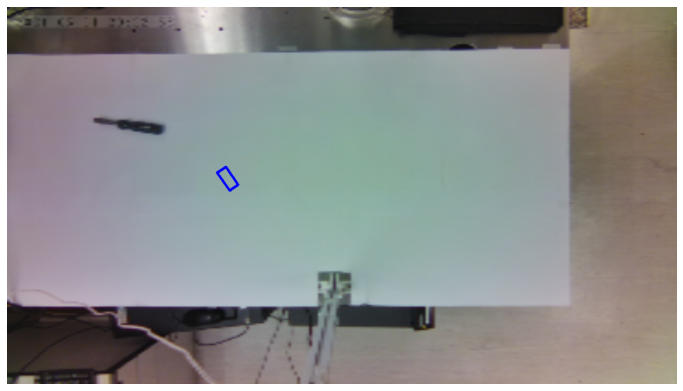

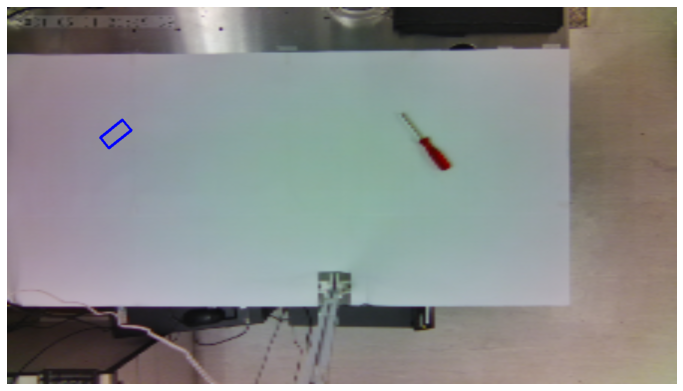

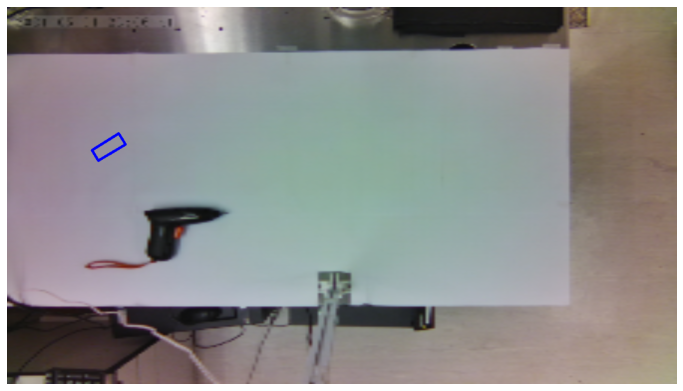

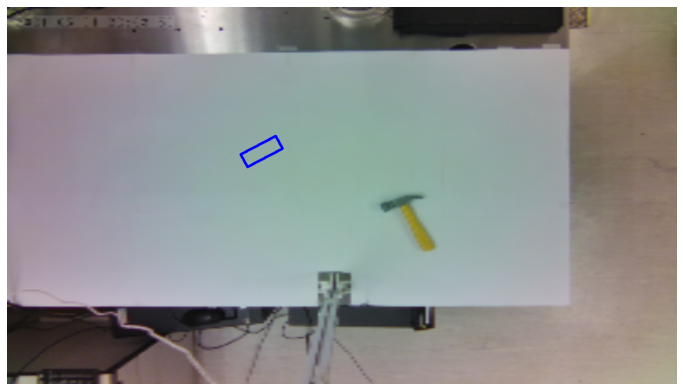

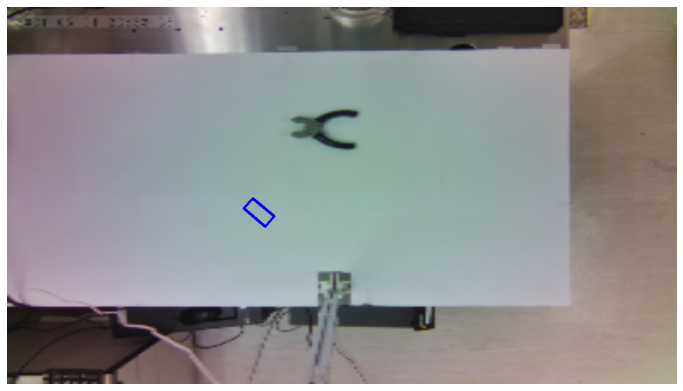

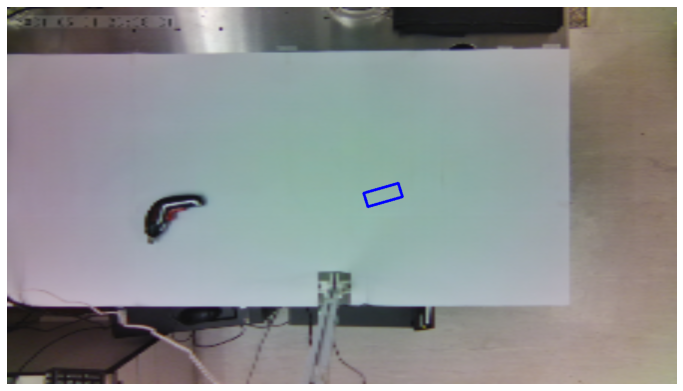

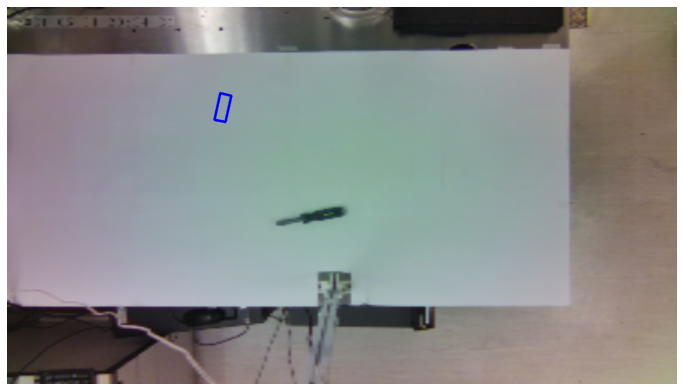

In [115]:
index = 10
imgs, labs = train_imgs[:index], pred[:index]
draw_box(imgs, labs)

In [116]:
############################ TEST ON TRAIN ############################

In [117]:
############################ TEST ON VALID ############################

In [118]:
print('Performance on valid set: {}'.format(final_model.evaluate(valid_ds)))

2/2 [==============================] - 0s 20ms/step - loss: 0.0612
Performance on valid set: 0.06118105351924896


In [127]:
valid_output = final_model.predict(valid_ds)
valid_pred = scaler.inverse_transform(valid_output)
valid_set = valid_ds.unbatch()
valid_imgs_set = valid_set.map(invprepocess_img, num_parallel_calls=AUTOTUNE)
valid_imgs_tensors = np.array([item for item in valid_imgs_set])
valid_imgs = [tensor for tensor in valid_imgs_tensors]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

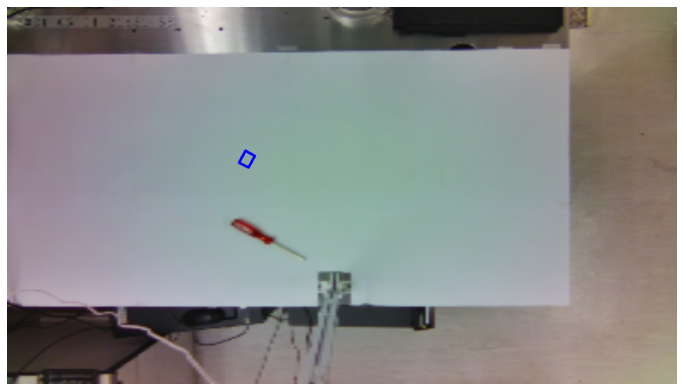

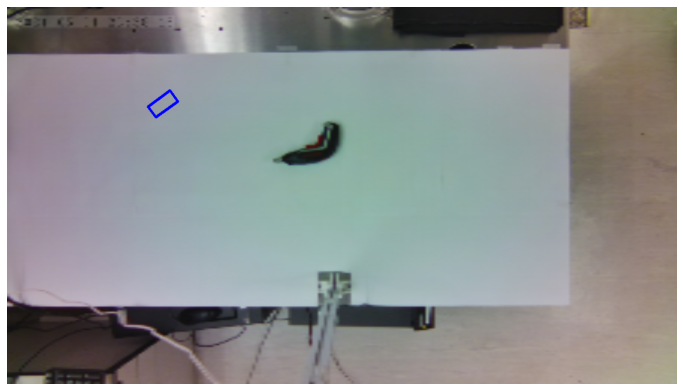

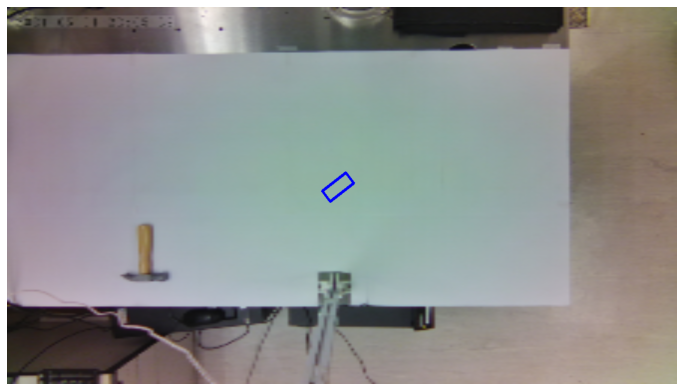

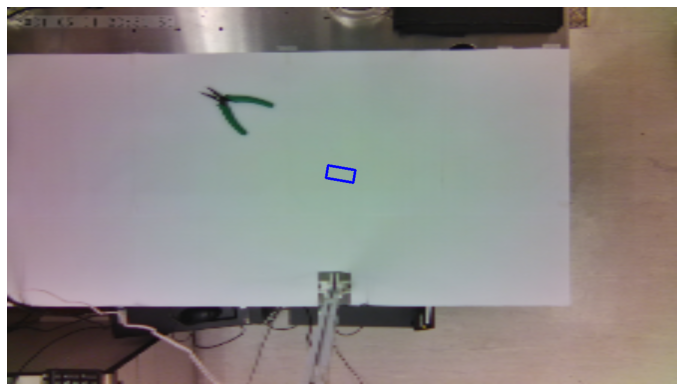

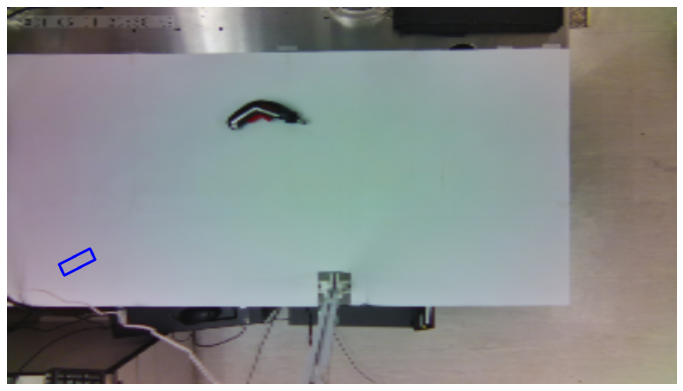

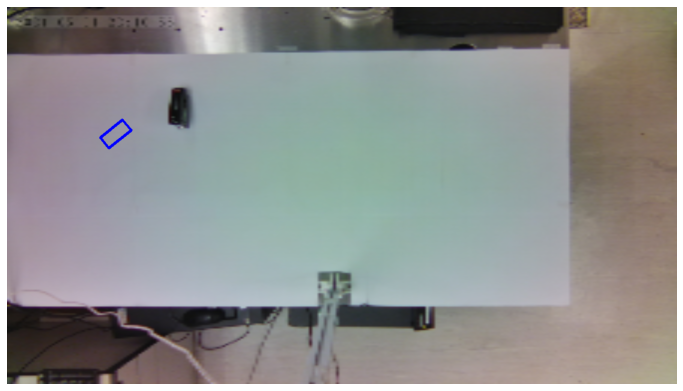

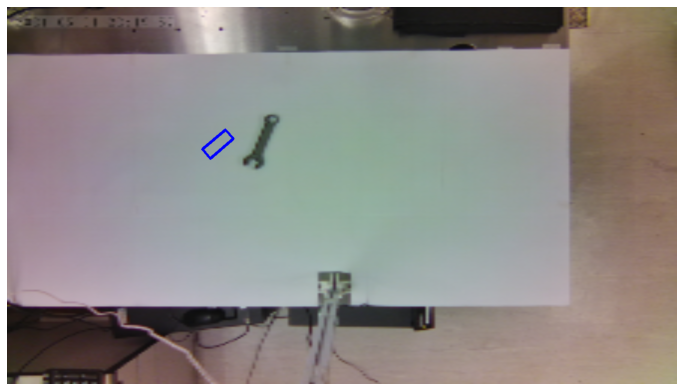

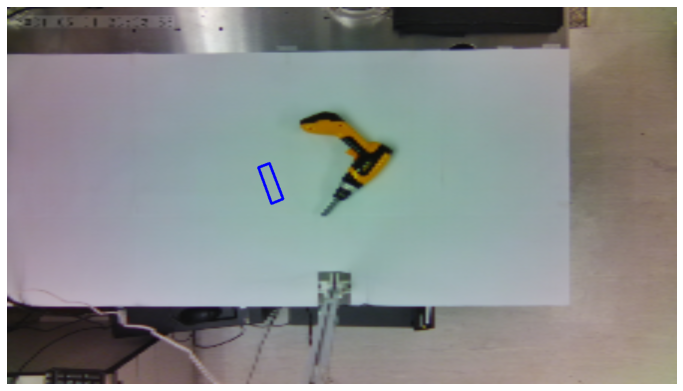

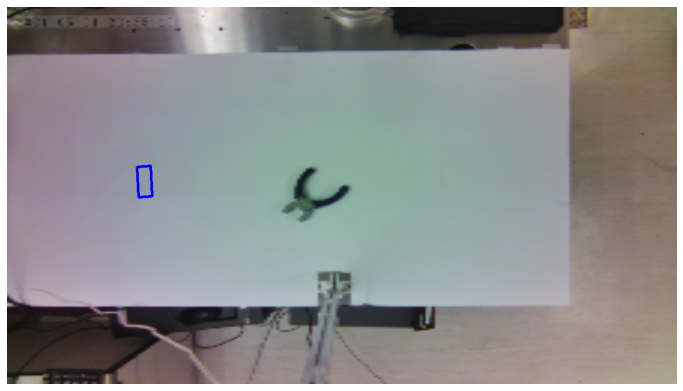

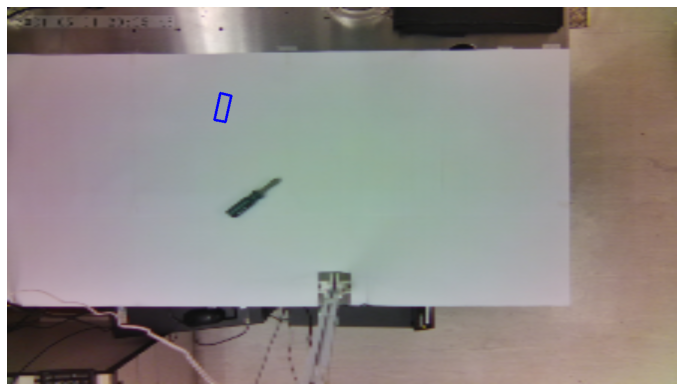

In [120]:
index = 10
imgs, labs = valid_imgs[:index], valid_pred[:index]
draw_box(imgs, labs)

In [121]:
############################ TEST ON VALID ############################

In [122]:
############################ TEST ON TEST ############################

In [123]:
print('Performance on test set: {}'.format(final_model.evaluate(test_ds)))

2/2 [==============================] - 0s 20ms/step - loss: 0.0467
Performance on test set: 0.04667754843831062


In [124]:
test_output = final_model.predict(test_ds)
test_pred = scaler.inverse_transform(test_output)
test_set = valid_ds.unbatch()
test_imgs_set = test_set.map(invprepocess_img, num_parallel_calls=AUTOTUNE)
test_imgs_tensors = np.array([item for item in test_imgs_set])
test_imgs = [tensor for tensor in test_imgs_tensors]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

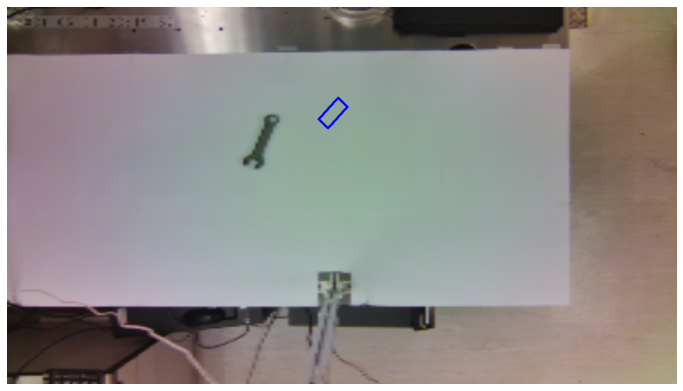

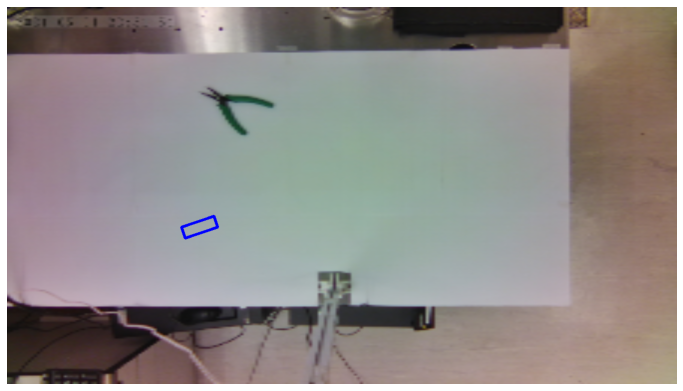

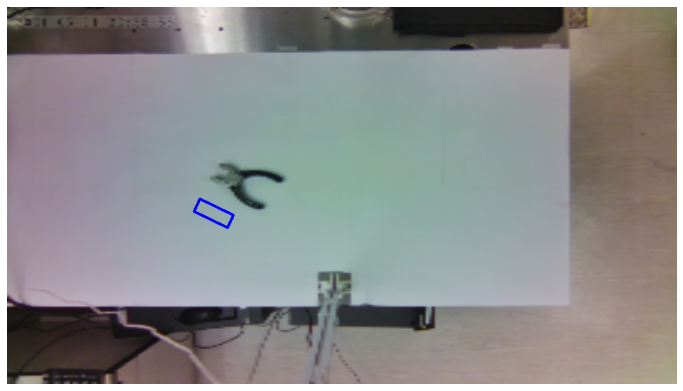

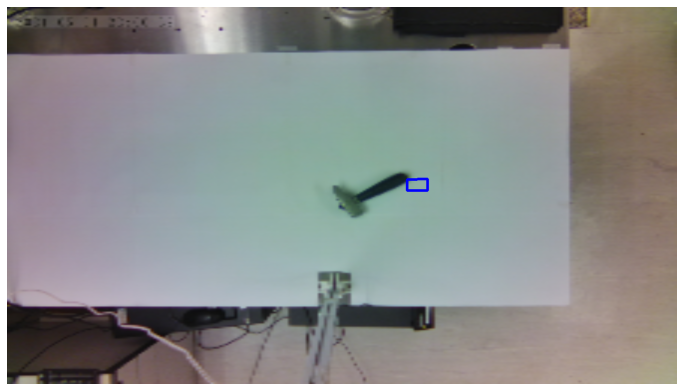

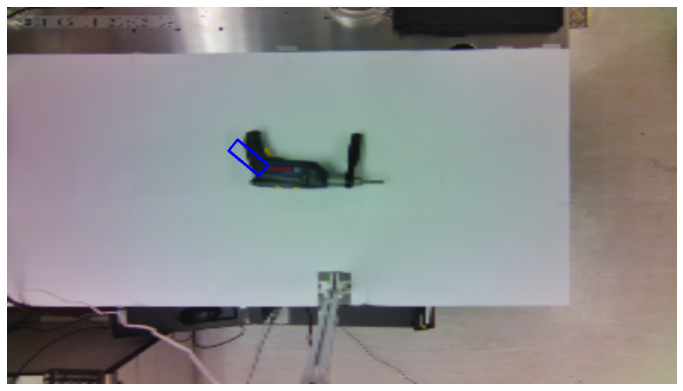

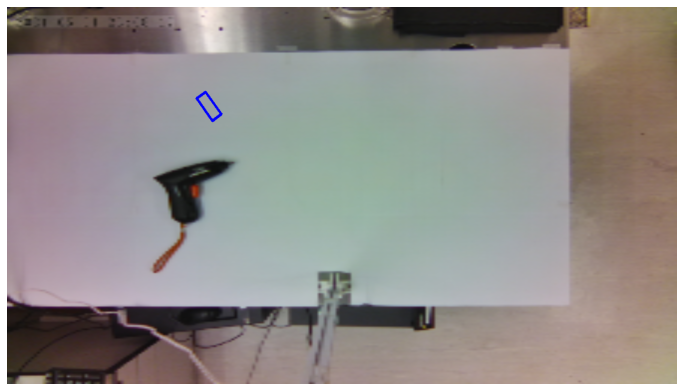

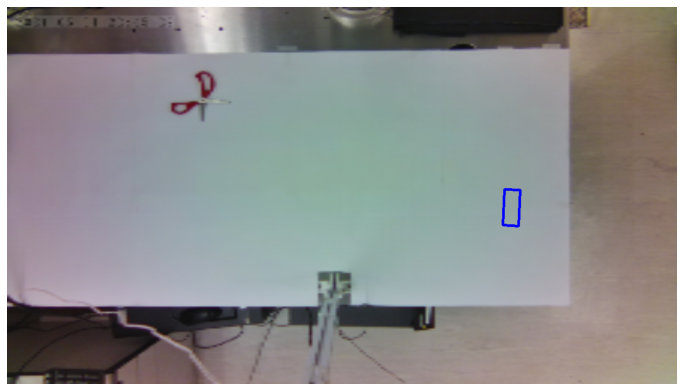

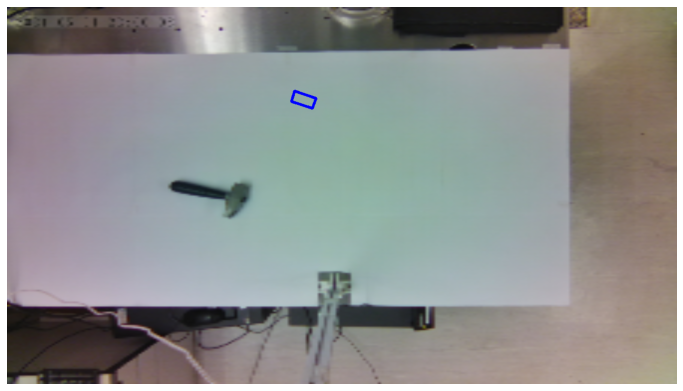

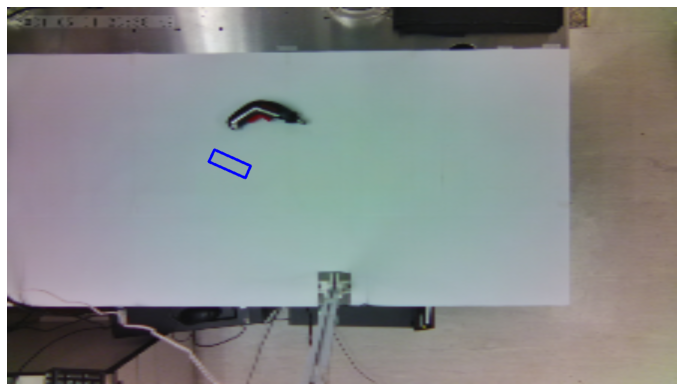

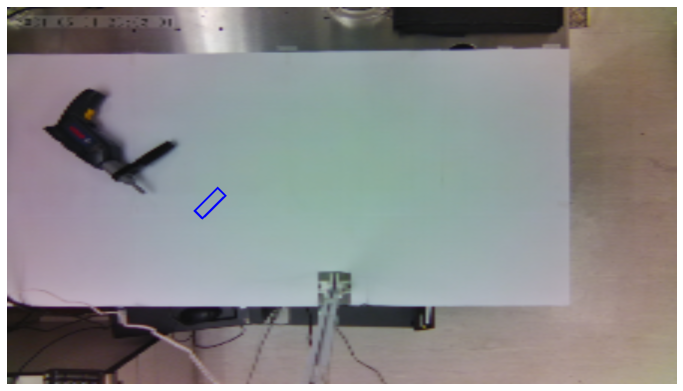

In [125]:
index = 10
imgs, labs = test_imgs[:index], test_pred[:index]
draw_box(imgs, labs)

In [126]:
############################ TEST ON TEST ############################